In this peroject, you will create a deep learning model that detects the TNt tubes formed in between cells. Below is a berief decsripton of what TNTs are:

"Tunneling nanotubes (TNTs) are elongated structures extending from and connecting cancer cell membranes. They permit the exchange of molecules, vesicles, and mitochondria, as well as genetic and metabolic signals that promote carcinogenesis. Given that they permit intercellular trafficking and communication, TNTs may serve as an important imaging biomarker of cancer cell response vs. resistance to therapy. On fluorescence imaging of cancer cell cultures, TNTs appear to be no thicker than 1 µm and vary in length from 10 to 100+ µm. TNTs can be spotted by a trained eye, but using human experts to obtain an accurate count and location of TNTs is a time-intensive process. A precise quantitative analysis of TNTs could aid in the objective assessment of cancer response to various therapeutic interventions."

In this project, the original images were created by taking a grid of 5 × 5 tiled images, each measuring 1388 × 1040 pixels, and then stitching them together. This process resulted in shadows along the stitched edges, which significantly degraded the model performance at later stages. You may start from removing these shadows. To remove those shadows, you may use BaSiC, an image correction method for background and shading correction for image sequences, available as a Fiji/ImageJ. You may consider other packages/lobraries for this purpose. You may also consider using different filters. You may check the following link: https://www.youtube.com/watch?v=xCHbcVUCYBI. You may find very useful short videos in that channel for image processing.

After preprocessing, you may want to divide the original image into smaller pieces. The original image in the training dataset was stitched together resulting in an image - size of 6283 × 4687 pixels. You can scan the images  with a sliding window of 512 × 512 pixels with a stride of 10 pixels, extracting patches containing the TNT regions using a bounding box. You may write a function that takes the window size as input. You may later create smaller images from 512x512 images using the same function.

Once you form training and test datasets from smaller images, you may simply train a VGG model. You may try different models. you goal is to find the images that contain TNTs. You may create multiple models that are trained with images with different sizes. 

# Image Preprocessing

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import cv2
import os
from PIL import Image
from skimage import io, filters
from scipy import ndimage
import sys
import random


This is the image with labels

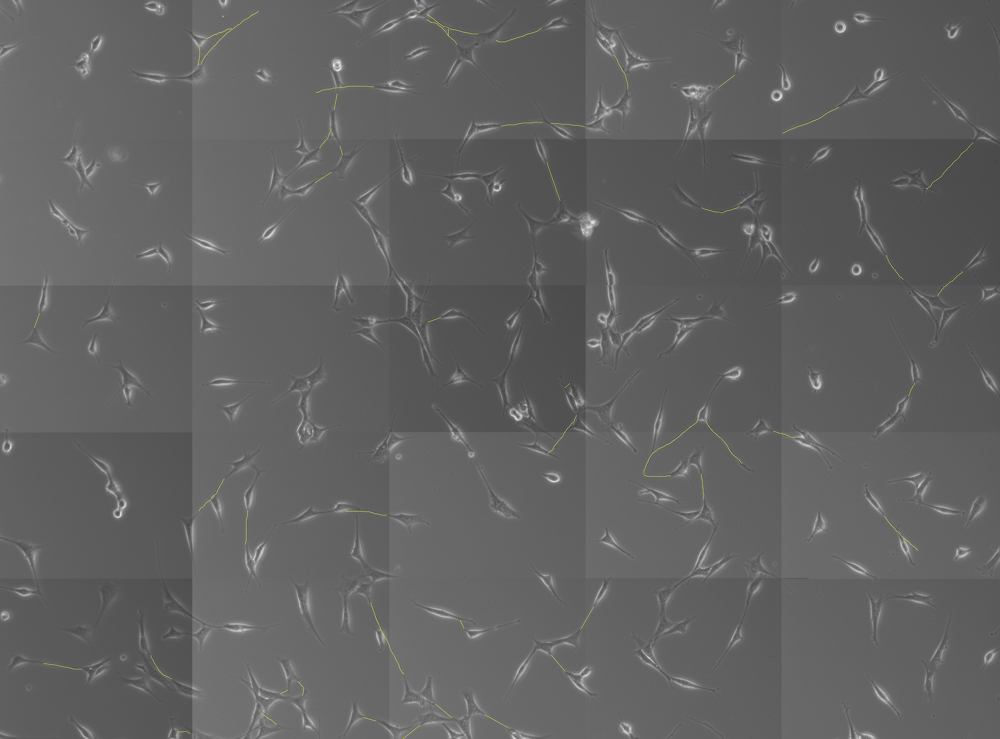

This is the same image without labels.

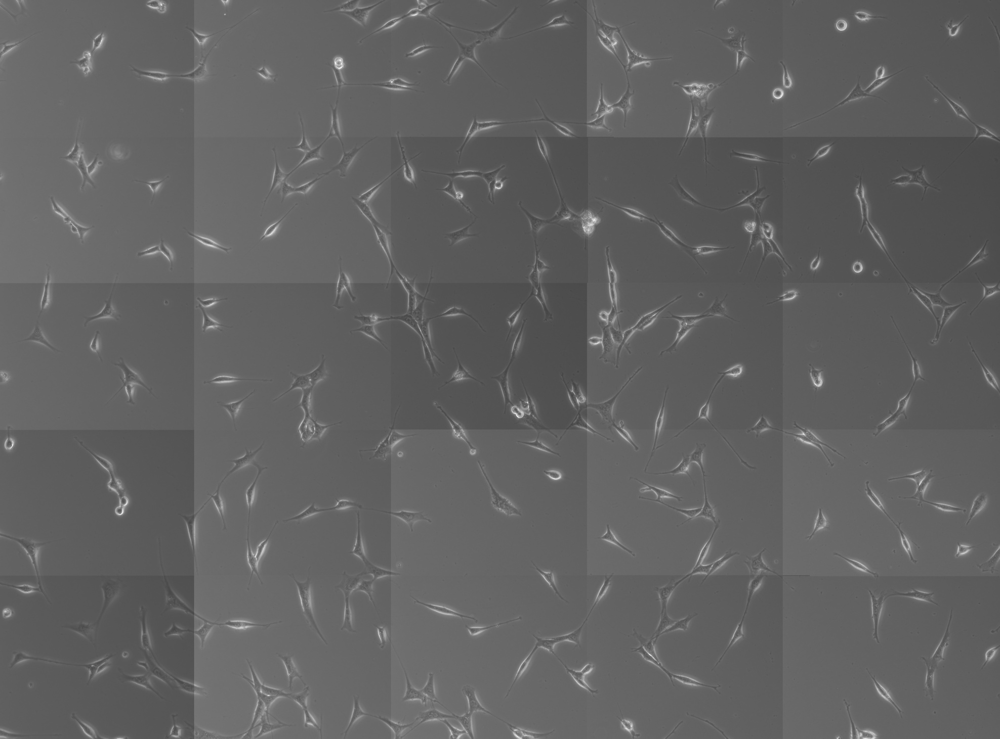

- Create folders to save the images that are created by splitting the main image into smaller pieces


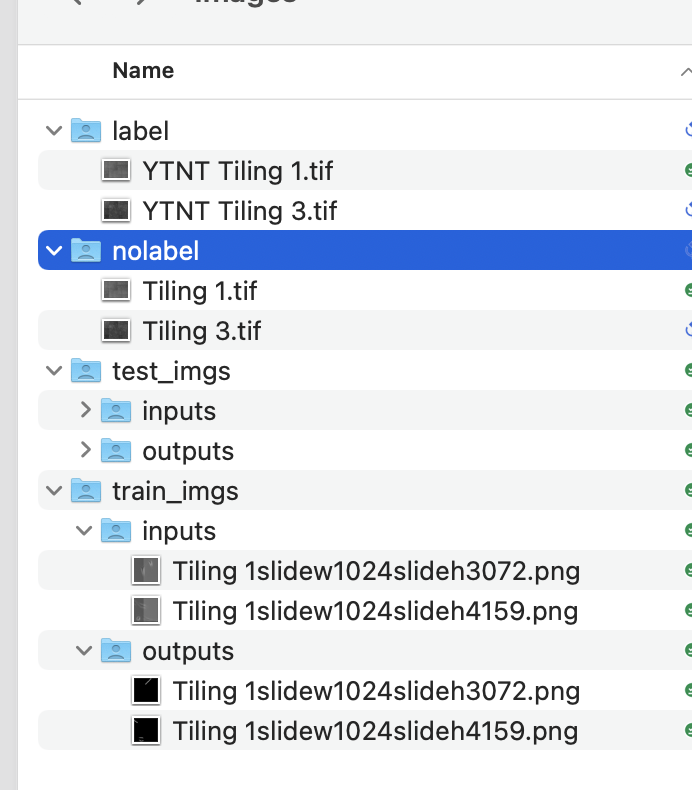

- Create smaller pieces from the main image by moving a window along the image. Mark the pieces with TNTs as 1 and all others as 0. This will give you the labeled images for your classification model.

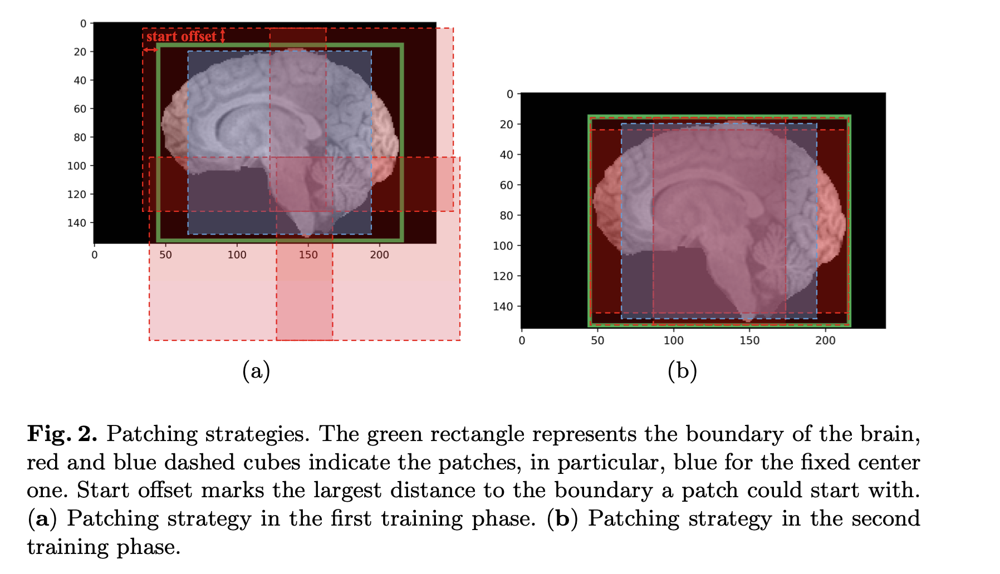

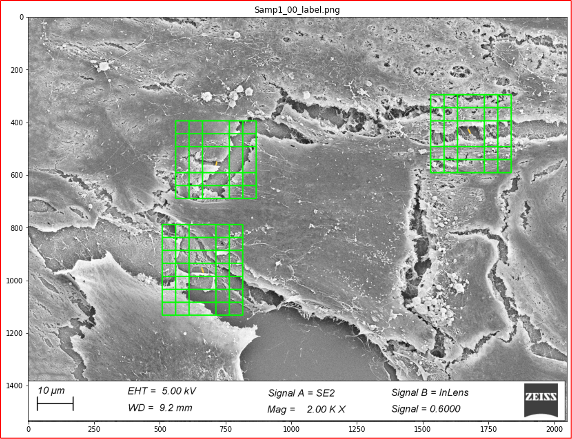

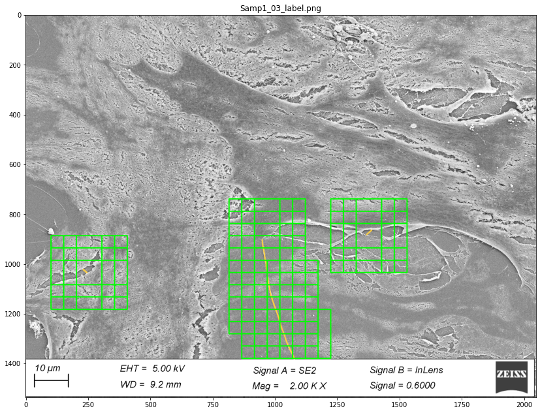

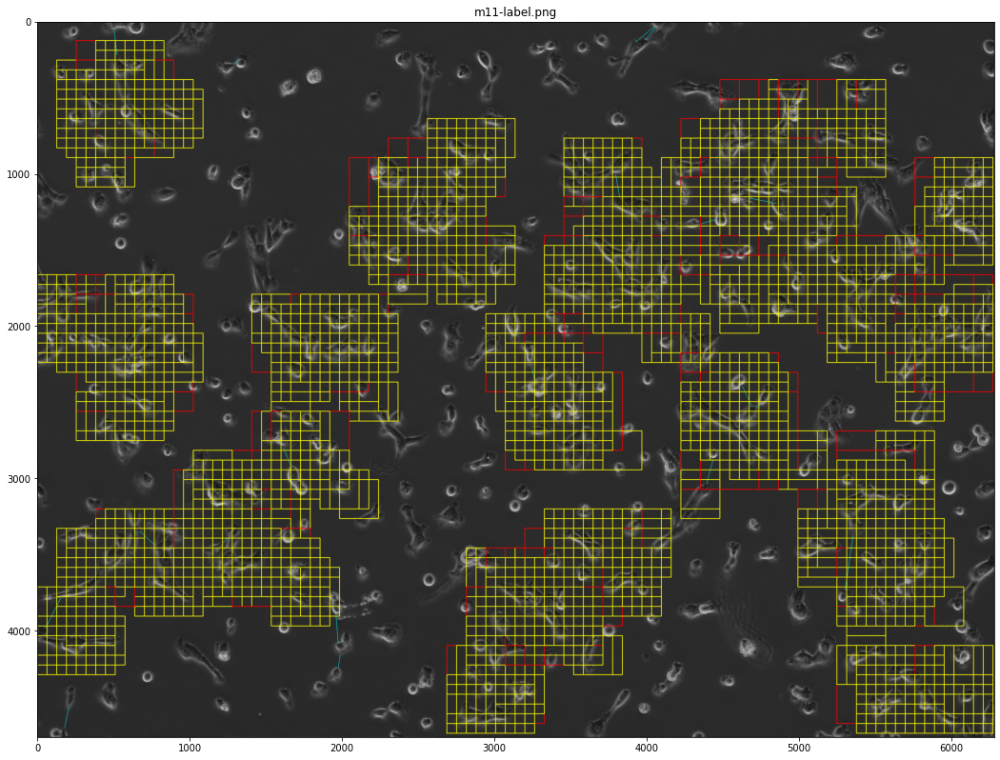

Need to be able to generate good masks that can identify labelled TNTs in the label image.

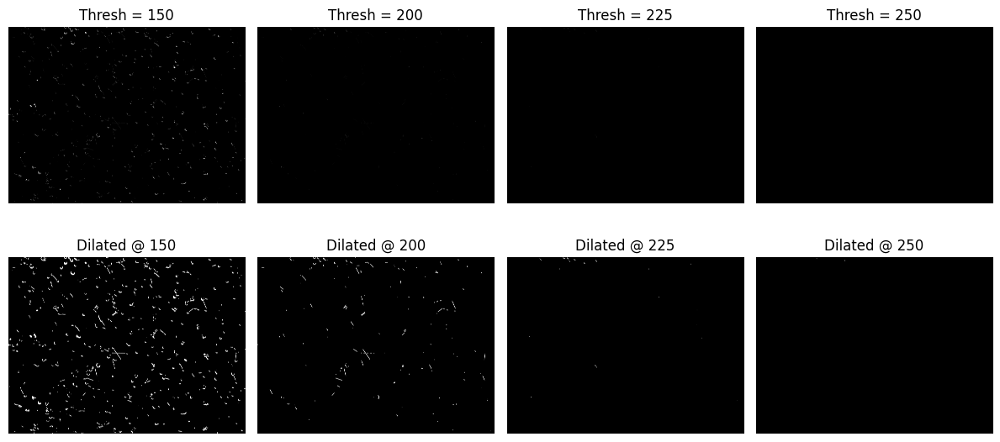

In [161]:

# Load the labeled image in grayscale
img = cv2.imread("m05-label.png", cv2.IMREAD_GRAYSCALE)

# Define a list of thresholds to test, this is the pixel value where anything >t is converted to 255 (white), generates bianry image
thresholds = [150, 200, 225, 250]
# defiune dilation kernel - this thickens the thin lines by applying a filter 
kernel = np.ones((3, 3), np.uint8 )

plt.figure(figsize=(12, 6))

for i, t in enumerate(thresholds):
    # Apply the threshold
    _, binary = cv2.threshold(img, t, 255, cv2.THRESH_BINARY)
    # dilute to thicken the thin nanotubule structure
    dilated = cv2.dilate(binary, kernel, iterations=5)

# show the thresholded image in the top row
    plt.subplot(2, len(thresholds), i + 1)
    plt.imshow(binary, cmap='gray')
    plt.title(f"Thresh = {t}")
    plt.axis('off')

    plt.subplot(2, len(thresholds), i + 1 + len(thresholds))
    plt.imshow(dilated, cmap='gray')
    plt.title(f"Dilated @ {t}")
    plt.axis('off')

plt.tight_layout()
plt.show()



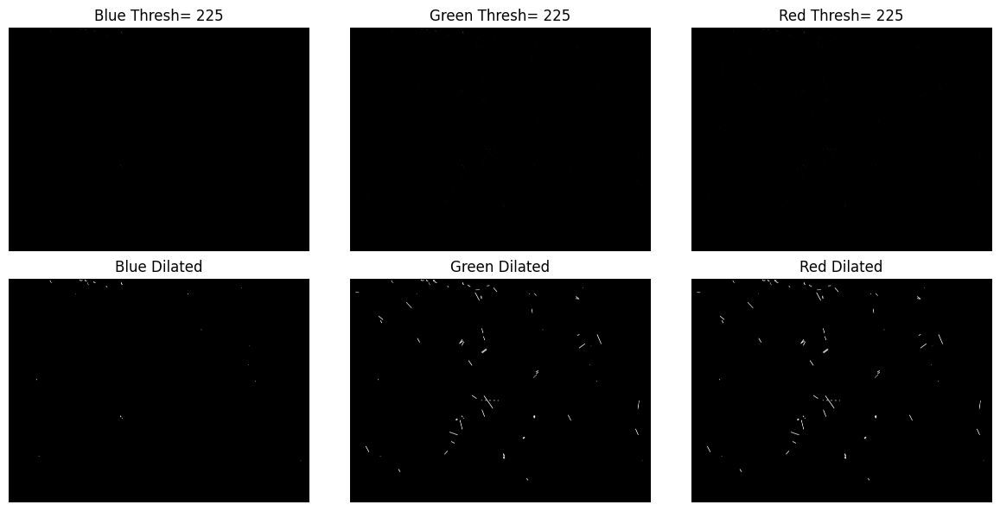

In [154]:
#Read the color image (BGR)
img_color = cv2.imread("m05-label.png", cv2.IMREAD_COLOR)

#Split into channels: b, g, r
b, g, r = cv2.split(img_color)

# define dilataion kernel
kernel = np.ones((3, 3), np.uint8)

channels = [('Blue', b), ('Green', g), ('Red', r)]
thresholded_images = []
dilated_images = []

for (chan_name, chan_data) in channels:
    # Threshold the single channel at threshold_value
    _, thresh = cv2.threshold(chan_data, 225, 255, cv2.THRESH_BINARY)
    dilated = cv2.dilate(thresh, kernel, iterations=5)
    thresholded_images.append((chan_name, thresh))
    dilated_images.append((chan_name, dilated))

plt.figure(figsize=(12, 6))

    # First row: thresholded images
for i, (chan_name, thresh_img) in enumerate(thresholded_images):
    plt.subplot(2, len(thresholded_images), i+1)
    plt.imshow(thresh_img, cmap='gray')
    plt.title(f"{chan_name} Thresh= 225")
    plt.axis('off')

    # Second row: dilated images
for i, (chan_name, dilated_img) in enumerate(dilated_images):
    plt.subplot(2, len(thresholded_images), i+1+len(thresholded_images))
    plt.imshow(dilated_img, cmap='gray')
    plt.title(f"{chan_name} Dilated")
    plt.axis('off')

plt.tight_layout()
plt.show()



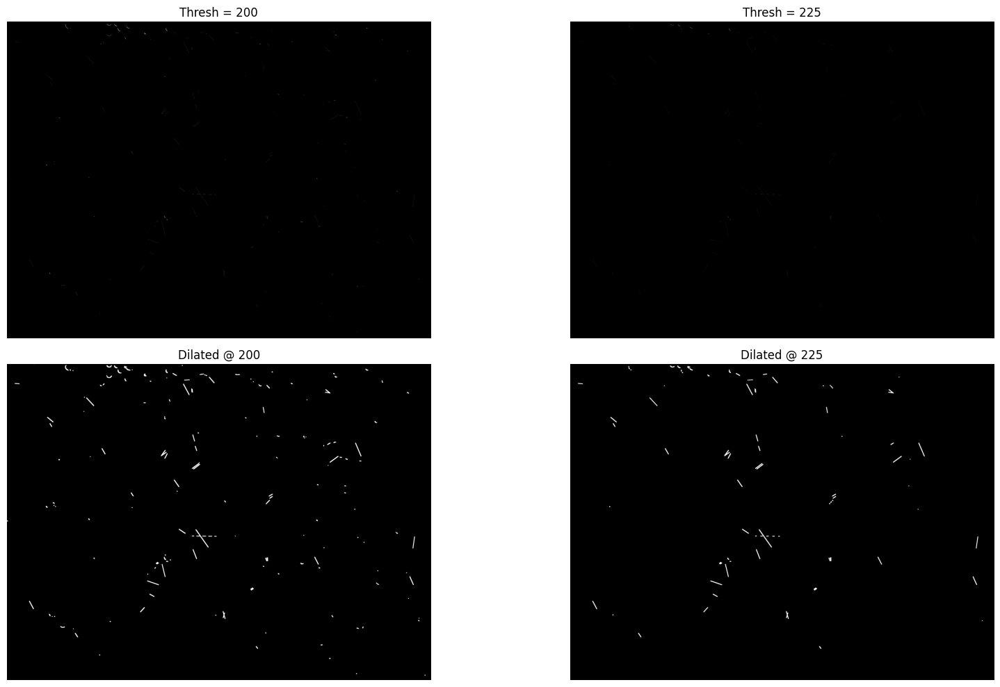

In [ ]:
# Load the labeled image in colour
img = cv2.imread("m05-label.png", cv2.IMREAD_COLOR)

# Split into color channels
b, g, r = cv2.split(img)

# Define a list of thresholds to test
thresholds = [200, 225]
kernel = np.ones((3, 3), np.uint8)

plt.figure(figsize=(18, 10))
for i, t in enumerate(thresholds):
    # Apply the threshold to the red channel
    _, binary = cv2.threshold(r, t, 255, cv2.THRESH_BINARY)
    # Dilate to thicken the thin nanotubule structure
    dilated = cv2.dilate(binary, kernel, iterations=5)
    # Show the thresholded image in the top row
    plt.subplot(2, len(thresholds), i + 1)
    plt.imshow(binary, cmap='gray')
    plt.title(f"Thresh = {t}")
    plt.axis('off')

    # Show the dilated image in the bottom row
    plt.subplot(2, len(thresholds), i + 1 + len(thresholds))
    plt.imshow(dilated, cmap='gray')
    plt.title(f"Dilated @ {t}")
    plt.axis('off')

plt.tight_layout()
plt.show()

Red channel using 225 threshold, and dilation (5 iteraions) looks cleanest. Use this for labelling

In [ ]:
def split_image_into_patches(
    img_path, 
    mask_path, 
    patch_size=512, 
    stride=10, 
    out_dir="dataset", 
    train_ratio=0.8,
    pixel_threshold=0.01  # Minimum fraction of positive pixels to label as TNT
):
    
    # Read images (in grayscale)
    img = cv2.imread(img_path, cv2.IMREAD_COLOR)
    mask = cv2.imread(mask_path, cv2.IMREAD_COLOR)
    
    # split the labelled image into rgb, use the red channel
    b, g, r = cv2.split(mask)
    # Preprocess the mask: threshold and dilate
    _, binary_mask = cv2.threshold(r, 225, 255, cv2.THRESH_BINARY) # THRESH_BINARY makes anyhting >t 255, everything else 0
    kernel = np.ones((3, 3), np.uint8)
    binary_mask = cv2.dilate(binary_mask, kernel, iterations=5) # use 5 iterations, like we foun when optimising TNT detection
    
    # Get image dimensions
    H, W, _ = img.shape  
    
    # Prepare output folders for classification
    train_tnt_dir = os.path.join(out_dir, "train", "tnt")
    train_no_tnt_dir = os.path.join(out_dir, "train", "no_tnt")
    test_tnt_dir = os.path.join(out_dir, "test", "tnt")
    test_no_tnt_dir = os.path.join(out_dir, "test", "no_tnt")
    
    for d in [train_tnt_dir, train_no_tnt_dir, test_tnt_dir, test_no_tnt_dir]:
        os.makedirs(d, exist_ok=True)

    # Extract and label patches, and store coordinates (x, y) for afterwards when we want to overlay onto the labelled image
    patches = []
    patch_id = 0
    for y in range(0, H - patch_size + 1, stride):
        for x in range(0, W - patch_size + 1, stride):
            img_patch = img[y:y+patch_size, x:x+patch_size]
            mask_patch = binary_mask[y:y+patch_size, x:x+patch_size]
            
            # Calculate the fraction of positive pixels in the mask patch
            positive_fraction = np.sum(mask_patch > 0) / (patch_size * patch_size)
            
            # Label the patch: 1 if fraction >= pixel_threshold, else 0
            label = 1 if positive_fraction >= pixel_threshold else 0  
            
            patches.append((img_patch, label, patch_id, x, y))
            patch_id += 1

    print(f"Total patches extracted: {len(patches)}")
    print(f"TNT patches: {sum([p[1] for p in patches])}")
    print(f"Non-TNT patches: {len(patches) - sum([p[1] for p in patches])}")

    # Shuffle and split into training and testing sets
    random.seed(42)
    random.shuffle(patches)
    train_size = int(len(patches) * train_ratio)
    train_patches = patches[:train_size]
    test_patches = patches[train_size:]

    # Save patches to disk in class-specific folders
    def save_patch(patch_img, label, patch_id, is_train=True):
        
        if is_train:
            base_dir = train_tnt_dir if label == 1 else train_no_tnt_dir
        else:
            base_dir = test_tnt_dir if label == 1 else test_no_tnt_dir
            
        cv2.imwrite(os.path.join(base_dir, f"patch_{patch_id}.png"), patch_img)

    # Save training patches (unpack all five elements)
    for img_patch, label, pid, x, y in train_patches:
        save_patch(img_patch, label, pid, is_train=True)
        
    # Save testing patches (also unpack coordinates)
    for img_patch, label, pid, x, y in test_patches:
        save_patch(img_patch, label, pid, is_train=False)
    
    print(f"Saved {len(train_patches)} training and {len(test_patches)} test patches")
    
    return patches

In [143]:
# Run the function
patches = split_image_into_patches(
    img_path="m05.png",
    mask_path="m05-label.png",
    patch_size=512,     
    stride=10,           # 10 generates a LOT of images. Make this stride larger, and augment the date instead to make up for it/reduce redundancy
    out_dir="dataset",  
    train_ratio=0.8,     
    pixel_threshold=0.001) # need to lower threshold somewhat to get good labelling, for some reason! Mask looks pretty good 


Total patches extracted: 241186
TNT patches: 82534
Non-TNT patches: 158652
Saved 192948 training and 48238 test patches


# Visualise my postive patches to make sure labelling is working okay

In [149]:
def visualize_positive_patches(original_img_path, patches, patch_size):
    # Load the original image in color (for visualization)
    original_img = cv2.imread(original_img_path, cv2.IMREAD_GRAYSCALE)
    if original_img is None:
        raise ValueError(f"Could not load image at {original_img_path}")

    # Create a copy of the image for drawing
    overlay_img = original_img.copy()

    # Loop through all patches and draw a rectangle if the patch is positive
    for (patch, label, patch_id, x, y) in patches:
        if label == 1:
            # Draw a red rectangle with thickness 2 around the positive patch
            cv2.rectangle(overlay_img, (x, y), (x + patch_size, y + patch_size), (0, 0, 255), 2)

    # Save the resulting overlay image or display it
    cv2.imwrite("positive_patches_overlay.png", overlay_img)


In [150]:
visualize_positive_patches("m05-label.png", patches, patch_size=512)


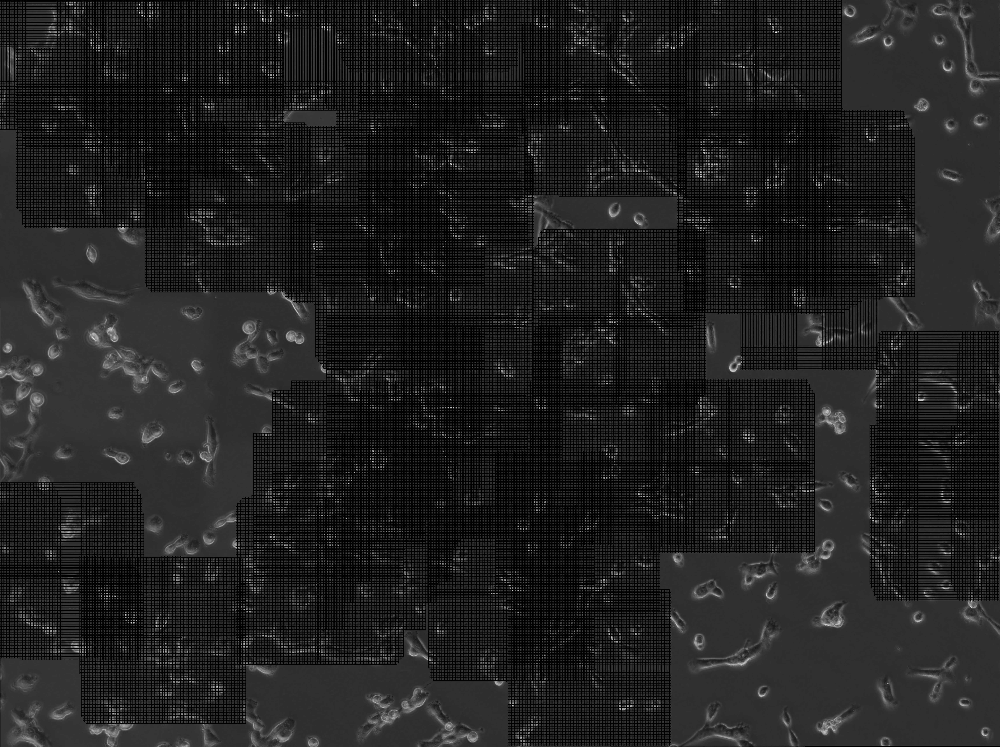

In [151]:
from IPython.display import Image, display
display(Image("positive_patches_overlay.png"))


# classification model training



- Use cv2.threshold and cv2.dilate to create image masks

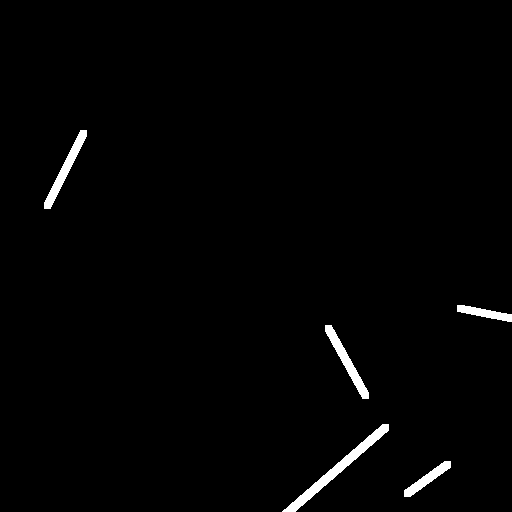

- Use transfer learning to create a classification model for images with and without TNTs
- You can start from and use VGG16
- Your goal is to run as many as models as the types of images you created in the preprocessing step, that is, if you created images of size 512 and 250 pixels, then you will have two models for each image size.